<a href="https://colab.research.google.com/github/Rawan-Hasan/Predictive-Analysis-of-delhivery-Logistics_/blob/main/performing_exploratory_data_analysis_for_Delhivery_k_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Performing exploratory data analysis for Delhivery-analysis

       
###  Features of the dataset:

- Column Profiling:

| Feature | Description |
|:--------|:------------|
|data| tells whether the data is testing or training data|
|trip_creation_time| Timestamp of trip creation|
|route_schedule_uuid| Unique ID for a particular route schedule|
|**route_type**| **Transportation type**|
|a. FTL–Full Truck Load| FTL shipments get to the destination sooner, as the truck is making no other pickups or drop-offs along the way|
|b. Carting | Handling system consisting of small vehicles (carts)|
|trip_uuid| Unique ID given to a particular trip (A trip may include different source and destination centers)|
|source_center| Source ID of trip origin |
|source_name| Source Name of trip origin |
|destination_center| Destination ID |
|destination_name| Destination Name |
|od_start_time| Trip start time |
|od_end_time| Trip end time |
|start_scan_to_end_scan | Time taken to deliver from source to destination |
|is_cutoff | Unknown field |
|cutoff_factor | Unknown field|
|cutoff_timestamp | Unknown field|
|actual_distance_to_destination | Distance in kms between source and destination warehouse|
|actual_time | Actual time taken to complete the delivery (Cumulative) |
|osrm_time | An open-source routing engine time calculator which computes the shortest path between points in a given map (Includes usual traffic, distance through major and minor roads) and gives the time (Cumulative) |
|osrm_distance | An open-source routing engine which computes the shortest path between points in a given map (Includes usual traffic, distance through major and minor roads) (Cumulative) |
|factor | Unknown field |
| segment_actual_time | This is a segment time. Time taken by the subset of the package delivery|
|segment_osrm_time | This is the OSRM segment time. Time taken by the subset of the package delivery|
| segment_osrm_distance | This is the OSRM distance. Distance covered by subset of the package delivery|
| segment_factor | Unknown field |

In [149]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import plotly.express as px
from scipy.stats import zscore
from sklearn.impute import SimpleImputer
from mpl_toolkits.mplot3d import Axes3D
import warnings
warnings.filterwarnings('ignore')

**Loading the dataset**

In [150]:
data=pd.read_csv('/content/delhivery_Logistics_with_scaled_data.csv')

In [151]:
data.head()

,data,trip_creation_time,route_schedule_uuid,route_type,trip_uuid,source_center,source_name,destination_center,destination_name,od_start_time,...,osrm_time_scaled,osrm_distance_scaled,start_scan_to_end_scan_scaled,factor_scaled,segment_actual_time_scaled,segment_osrm_time_scaled,segment_osrm_distance_scaled,segment_factor_scaled,osrm_distance_time_ratio_scaled,distance_time_ratio_scaled
0,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,0.002227,0.000926,0.011403,0.064982,0.082840,0.152778,0.154596,0.181818,0.475918,0.997996
1,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,0.008909,0.006231,0.011403,0.053023,0.059172,0.125000,0.126090,0.168889,0.473903,0.996711
2,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,0.014848,0.012109,0.011403,0.090608,0.094675,0.097222,0.139737,0.262857,0.573278,0.990452
3,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,0.023756,0.019188,0.011403,0.110576,0.124260,0.166667,0.168255,0.220000,0.543070,0.978861
4,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,0.026726,0.023893,0.011403,0.109828,0.035503,0.069444,0.050587,0.176000,0.665052,0.976519


 **Feature Engineering**

- Create a new feature for the trip_route_id for each trip_uuid   and route_schedule_uuid

In [152]:
# Merge trip_uuid and route_schedule_uuid
data['trip_route_id'] = data['trip_uuid'] + '_' + data['route_schedule_uuid']

In [153]:
# Extract city ,code and state from destination_name
data[['destination','destination_state']] = data['destination_name'].str.split('(', n=1, expand=True)
data['destination_state'] = data['destination_state'].str.rstrip(')')
data[['destination_City','destination_place','destination_code']] = data['destination'].str.split('_', n=2, expand=True)

In [154]:
# Extract city ,code and state from source_name
data[['source','source_state']] = data['source_name'].str.split('(', n=1, expand=True)
data['source_state'] = data['source_state'].str.rstrip(')')
data[['source_City','source_place','source_code']] = data['source'].str.split('_', n=2, expand=True)

# Verify the updated DataFrame
data.head()

,data,trip_creation_time,route_schedule_uuid,route_type,trip_uuid,source_center,source_name,destination_center,destination_name,od_start_time,...,destination,destination_state,destination_City,destination_place,destination_code,source,source_state,source_City,source_place,source_code
0,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,Khambhat_MotvdDPP_D,Gujarat,Khambhat,MotvdDPP,D,Anand_VUNagar_DC,Gujarat,Anand,VUNagar,DC
1,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,Khambhat_MotvdDPP_D,Gujarat,Khambhat,MotvdDPP,D,Anand_VUNagar_DC,Gujarat,Anand,VUNagar,DC
2,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,Khambhat_MotvdDPP_D,Gujarat,Khambhat,MotvdDPP,D,Anand_VUNagar_DC,Gujarat,Anand,VUNagar,DC
3,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,Khambhat_MotvdDPP_D,Gujarat,Khambhat,MotvdDPP,D,Anand_VUNagar_DC,Gujarat,Anand,VUNagar,DC
4,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,Khambhat_MotvdDPP_D,Gujarat,Khambhat,MotvdDPP,D,Anand_VUNagar_DC,Gujarat,Anand,VUNagar,DC


In [155]:
data[['destination_City','destination_place','destination_code']].head()

,destination_City,destination_place,destination_code
0,Khambhat,MotvdDPP,D
1,Khambhat,MotvdDPP,D
2,Khambhat,MotvdDPP,D
3,Khambhat,MotvdDPP,D
4,Khambhat,MotvdDPP,D


## Exploratory Data Analysis (EDA)




In [156]:
# view the first few rows to understand its structure and contents
data.head()

,data,trip_creation_time,route_schedule_uuid,route_type,trip_uuid,source_center,source_name,destination_center,destination_name,od_start_time,...,destination,destination_state,destination_City,destination_place,destination_code,source,source_state,source_City,source_place,source_code
0,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,Khambhat_MotvdDPP_D,Gujarat,Khambhat,MotvdDPP,D,Anand_VUNagar_DC,Gujarat,Anand,VUNagar,DC
1,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,Khambhat_MotvdDPP_D,Gujarat,Khambhat,MotvdDPP,D,Anand_VUNagar_DC,Gujarat,Anand,VUNagar,DC
2,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,Khambhat_MotvdDPP_D,Gujarat,Khambhat,MotvdDPP,D,Anand_VUNagar_DC,Gujarat,Anand,VUNagar,DC
3,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,Khambhat_MotvdDPP_D,Gujarat,Khambhat,MotvdDPP,D,Anand_VUNagar_DC,Gujarat,Anand,VUNagar,DC
4,training,2018-09-20 02:35:36.476840,thanos::sroute:eb7bfc78-b351-4c0e-a951-fa3d5c3...,Carting,trip-153741093647649320,IND388121AAA,Anand_VUNagar_DC (Gujarat),IND388620AAB,Khambhat_MotvdDPP_D (Gujarat),2018-09-20 03:21:32.418600,...,Khambhat_MotvdDPP_D,Gujarat,Khambhat,MotvdDPP,D,Anand_VUNagar_DC,Gujarat,Anand,VUNagar,DC


In [157]:
# view the last few rows
data.tail()

,data,trip_creation_time,route_schedule_uuid,route_type,trip_uuid,source_center,source_name,destination_center,destination_name,od_start_time,...,destination,destination_state,destination_City,destination_place,destination_code,source,source_state,source_City,source_place,source_code
144862,training,2018-09-20 16:24:28.436231,thanos::sroute:f0569d2f-4e20-4c31-8542-67b86d5...,Carting,trip-153746066843555182,IND131028AAB,Sonipat_Kundli_H (Haryana),IND000000ACB,Gurgaon_Bilaspur_HB (Haryana),2018-09-20 16:24:28.436231,...,Gurgaon_Bilaspur_HB,Haryana,Gurgaon,Bilaspur,HB,Sonipat_Kundli_H,Haryana,Sonipat,Kundli,H
144863,training,2018-09-20 16:24:28.436231,thanos::sroute:f0569d2f-4e20-4c31-8542-67b86d5...,Carting,trip-153746066843555182,IND131028AAB,Sonipat_Kundli_H (Haryana),IND000000ACB,Gurgaon_Bilaspur_HB (Haryana),2018-09-20 16:24:28.436231,...,Gurgaon_Bilaspur_HB,Haryana,Gurgaon,Bilaspur,HB,Sonipat_Kundli_H,Haryana,Sonipat,Kundli,H
144864,training,2018-09-20 16:24:28.436231,thanos::sroute:f0569d2f-4e20-4c31-8542-67b86d5...,Carting,trip-153746066843555182,IND131028AAB,Sonipat_Kundli_H (Haryana),IND000000ACB,Gurgaon_Bilaspur_HB (Haryana),2018-09-20 16:24:28.436231,...,Gurgaon_Bilaspur_HB,Haryana,Gurgaon,Bilaspur,HB,Sonipat_Kundli_H,Haryana,Sonipat,Kundli,H
144865,training,2018-09-20 16:24:28.436231,thanos::sroute:f0569d2f-4e20-4c31-8542-67b86d5...,Carting,trip-153746066843555182,IND131028AAB,Sonipat_Kundli_H (Haryana),IND000000ACB,Gurgaon_Bilaspur_HB (Haryana),2018-09-20 16:24:28.436231,...,Gurgaon_Bilaspur_HB,Haryana,Gurgaon,Bilaspur,HB,Sonipat_Kundli_H,Haryana,Sonipat,Kundli,H
144866,training,2018-09-20 16:24:28.436231,thanos::sroute:f0569d2f-4e20-4c31-8542-67b86d5...,Carting,trip-153746066843555182,IND131028AAB,Sonipat_Kundli_H (Haryana),IND000000ACB,Gurgaon_Bilaspur_HB (Haryana),2018-09-20 16:24:28.436231,...,Gurgaon_Bilaspur_HB,Haryana,Gurgaon,Bilaspur,HB,Sonipat_Kundli_H,Haryana,Sonipat,Kundli,H


In [158]:
# view the random rows
data.sample(5)

,data,trip_creation_time,route_schedule_uuid,route_type,trip_uuid,source_center,source_name,destination_center,destination_name,od_start_time,...,destination,destination_state,destination_City,destination_place,destination_code,source,source_state,source_City,source_place,source_code
93793,test,2018-10-03 01:19:57.756823,thanos::sroute:36941a6b-0e90-4582-a95a-96666dc...,Carting,trip-153852959775655290,IND423701AAB,Vaijiapur_YeolaRD_D (Maharashtra),IND422011AAD,Nashik_TgrniaRD_I (Maharashtra),2018-10-03 09:36:30.407827,...,Nashik_TgrniaRD_I,Maharashtra,Nashik,TgrniaRD,I,Vaijiapur_YeolaRD_D,Maharashtra,Vaijiapur,YeolaRD,D
67375,test,2018-10-02 17:10:51.060087,thanos::sroute:39ff45be-5a5a-48f0-8d2d-17305e3...,Carting,trip-153850025105979660,IND560048AAB,Bengaluru_Hoodi_IP (Karnataka),IND562132AAA,Bangalore_Nelmngla_H (Karnataka),2018-10-02 17:10:51.060087,...,Bangalore_Nelmngla_H,Karnataka,Bangalore,Nelmngla,H,Bengaluru_Hoodi_IP,Karnataka,Bengaluru,Hoodi,IP
102248,test,2018-09-28 04:44:15.251244,thanos::sroute:a4bf93af-8105-4dff-818e-cb79ddd...,FTL,trip-153810985525098933,IND000000ACB,Gurgaon_Bilaspur_HB (Haryana),IND521225AAB,Vijayawada_Rynapadu_H (Andhra Pradesh),2018-09-28 04:44:15.251244,...,Vijayawada_Rynapadu_H,Andhra Pradesh,Vijayawada,Rynapadu,H,Gurgaon_Bilaspur_HB,Haryana,Gurgaon,Bilaspur,HB
91770,training,2018-09-15 00:24:27.649082,thanos::sroute:b43ec86d-59c1-452c-b4a9-807d357...,FTL,trip-153697106764662678,IND411033AAA,Pune_Tathawde_H (Maharashtra),IND501359AAE,Hyderabad_Shamshbd_H (Telangana),2018-09-15 00:24:27.649082,...,Hyderabad_Shamshbd_H,Telangana,Hyderabad,Shamshbd,H,Pune_Tathawde_H,Maharashtra,Pune,Tathawde,H
68555,training,2018-09-18 09:59:32.711062,thanos::sroute:9e82b6d4-e07b-4a74-bfe0-7c72f28...,FTL,trip-153726477271073394,IND184104AAA,Kathua_BOB_D (Jammu & Kashmir),IND160002AAC,Chandigarh_Mehmdpur_H (Punjab),2018-09-19 11:29:52.575949,...,Chandigarh_Mehmdpur_H,Punjab,Chandigarh,Mehmdpur,H,Kathua_BOB_D,Jammu & Kashmir,Kathua,BOB,D


In [159]:
data.columns

Index(['data', 'trip_creation_time', 'route_schedule_uuid', 'route_type',
       'trip_uuid', 'source_center', 'source_name', 'destination_center',
       'destination_name', 'od_start_time', 'od_end_time',
       'start_scan_to_end_scan', 'is_cutoff', 'cutoff_factor',
       'cutoff_timestamp', 'actual_distance_to_destination', 'actual_time',
       'osrm_time', 'osrm_distance', 'factor', 'segment_actual_time',
       'segment_osrm_time', 'segment_osrm_distance', 'segment_factor',
       'time_to_start', 'time_taken', 'hour_of__day', 'day_of_week',
       'month_of_year', 'osrm_distance_time_ratio', 'distance_time_ratio',
       'time_to_start_scaled', 'time_taken_scaled',
       'actual_distance_to_destination_scaled', 'actual_time_scaled',
       'osrm_time_scaled', 'osrm_distance_scaled',
       'start_scan_to_end_scan_scaled', 'factor_scaled',
       'segment_actual_time_scaled', 'segment_osrm_time_scaled',
       'segment_osrm_distance_scaled', 'segment_factor_scaled',
       'os

**Drop  columns**

In [160]:
data.drop(['time_to_start', 'time_taken',
       'actual_distance_to_destination', 'actual_time',
       'osrm_time', 'osrm_distance',
       'start_scan_to_end_scan', 'factor',
       'segment_actual_time', 'segment_osrm_time',
       'segment_osrm_distance', 'segment_factor',
       'osrm_distance_time_ratio', 'distance_time_ratio'],inplace=True ,axis=1)

**Missing values**

In [161]:
# Display summary of missing values
print('Missing Values Sum fo each value:')
print(data.isnull().sum())

Missing Values Sum fo each value:
data                                         0
trip_creation_time                           0
route_schedule_uuid                          0
route_type                                   0
trip_uuid                                    0
source_center                                0
source_name                                  0
destination_center                           0
destination_name                             0
od_start_time                                0
od_end_time                                  0
is_cutoff                                    0
cutoff_factor                                0
cutoff_timestamp                          3429
hour_of__day                                 0
day_of_week                                  0
month_of_year                                0
time_to_start_scaled                         0
time_taken_scaled                            0
actual_distance_to_destination_scaled        0
actual_time_scaled        

 cutoff_timestamp 3429 , source_place  2107,
source_code   14650, destination_place  2441 &
destination_code  15568 have  a missing values.

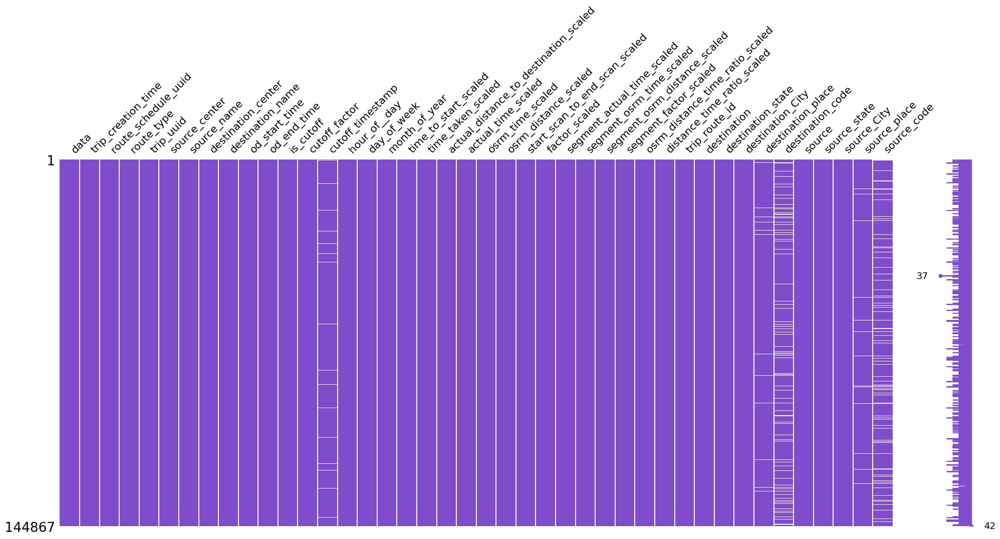

There are 3429 missing values in cutoff_timestamp
There are 2441 missing values in destination_place
There are 15568 missing values in destination_code
There are 2107 missing values in source_place
There are 14650 missing values in source_code


In [162]:
msno.matrix(data,color=(0.50,0.30,0.80))
plt.show()
x=data.isnull().sum()
for a,b in x.items():
    if b>0:
        print(f'There are {b} missing values in {a}')

-  Handle Missing value

In [163]:
# Handle missing value for numeric
data['cutoff_timestamp'].fillna(data['cutoff_timestamp'].median,inplace=True)

In [164]:
# Handle missing value for categorical features
for i in ['source_place', 'destination_code','source_code', 'destination_place']:
    data[i].fillna(data[i].mode().iloc[0],inplace=True)

In [165]:
# check
data.isnull().sum()

,0
data,0
trip_creation_time,0
route_schedule_uuid,0
route_type,0
trip_uuid,0
source_center,0
source_name,0
destination_center,0
destination_name,0
od_start_time,0


**summary statistics**

In [166]:
data.describe(include='number').T

,count,mean,std,min,25%,50%,75%,max
cutoff_factor,144867.0,231.718217,340.092319,9.0,22.000000,66.000000,286.000000,1474.0
hour_of__day,144867.0,12.652516,7.949513,0.0,5.000000,15.000000,20.000000,23.0
time_to_start_scaled,144867.0,0.113934,0.196677,0.0,0.000000,0.000000,0.162703,1.0
time_taken_scaled,144867.0,0.260213,0.293653,0.0,0.032742,0.114773,0.452809,1.0
actual_distance_to_destination_scaled,144867.0,0.151960,0.231207,0.0,0.009677,0.038716,0.188475,1.0
actual_time_scaled,144867.0,0.154879,0.227248,0.0,0.014313,0.045648,0.193037,1.0
osrm_time_scaled,144867.0,0.152007,0.225346,0.0,0.014105,0.041574,0.184855,1.0
osrm_distance_scaled,144867.0,0.148480,0.225979,0.0,0.010683,0.037107,0.180973,1.0
start_scan_to_end_scan_scaled,144867.0,0.260232,0.293626,0.0,0.032782,0.114880,0.452680,1.0
factor_scaled,144867.0,0.193933,0.145881,0.0,0.119499,0.161081,0.219677,1.0


In [167]:
# Separate column names by data type
cat=data.select_dtypes(include='object')
num=data.select_dtypes(include='number')
print('categorical_columns :\n ',cat.columns)
print('********************************************************************')
print('numerical_columns :\n ',num.columns)

categorical_columns :
  Index(['data', 'trip_creation_time', 'route_schedule_uuid', 'route_type',
       'trip_uuid', 'source_center', 'source_name', 'destination_center',
       'destination_name', 'od_start_time', 'od_end_time', 'cutoff_timestamp',
       'day_of_week', 'month_of_year', 'trip_route_id', 'destination',
       'destination_state', 'destination_City', 'destination_place',
       'destination_code', 'source', 'source_state', 'source_City',
       'source_place', 'source_code'],
      dtype='object')
********************************************************************
numerical_columns :
  Index(['cutoff_factor', 'hour_of__day', 'time_to_start_scaled',
       'time_taken_scaled', 'actual_distance_to_destination_scaled',
       'actual_time_scaled', 'osrm_time_scaled', 'osrm_distance_scaled',
       'start_scan_to_end_scan_scaled', 'factor_scaled',
       'segment_actual_time_scaled', 'segment_osrm_time_scaled',
       'segment_osrm_distance_scaled', 'segment_factor_scaled

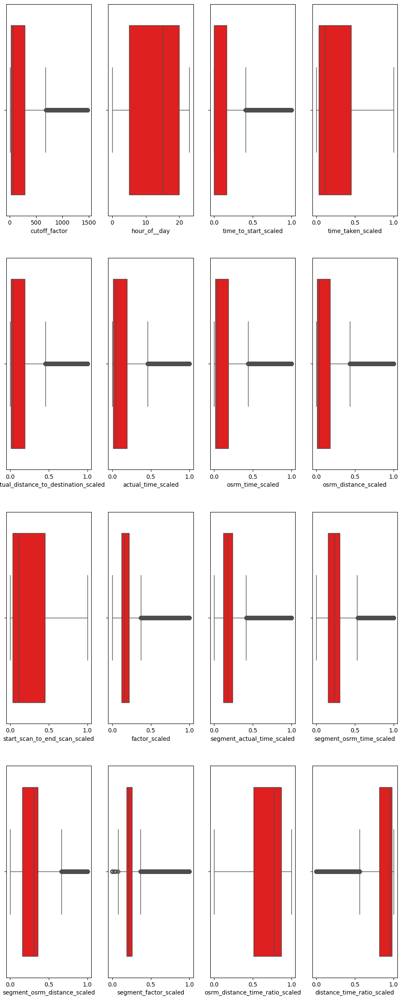

In [168]:
# Plot outliers for each numerical column
fig, axes = plt.subplots(4, 4, figsize=(12, 30))
axes = axes.flatten()
for i, c in enumerate(num):
    sns.boxplot(x=data[c],ax=axes[i],color='red')

**Detect any outliers in numerical data by  Z_score**

In [169]:
z_scores = num.apply(zscore)
outliers = (z_scores.abs() > 3).sum()

outliers

,0
cutoff_factor,3688
hour_of__day,0
time_to_start_scaled,4191
time_taken_scaled,0
actual_distance_to_destination_scaled,3576
actual_time_scaled,3779
osrm_time_scaled,3753
osrm_distance_scaled,3755
start_scan_to_end_scan_scaled,0
factor_scaled,3505


# Data Visualisation

### Univariate Data Analysis

> - For each categorical feature, analyze the frequency distribution using bar plots or pie charts.

>    - For each numerical feature analyze its distribution using histograms, kernel density plots, and summary statistics.
   





**Most prefered route type for delivery**

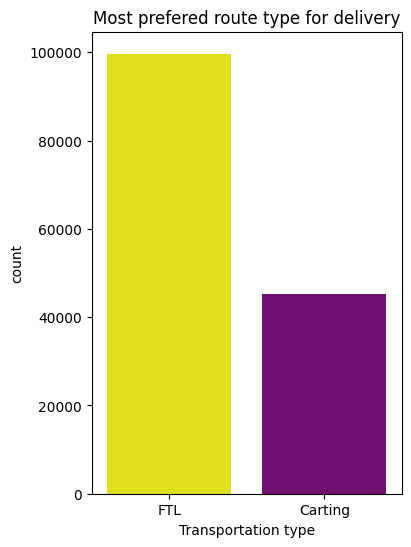

In [170]:
plt.figure(figsize=(4,6))
plt.ticklabel_format(style='plain')
color_sequences = ['yellow', 'purple']

sns.barplot(x=data['route_type'].value_counts().index, y=data['route_type'].value_counts().values,palette=color_sequences)
plt.title('Most prefered route type for delivery')
plt.xlabel('Transportation type')
plt.ylabel('count')

plt.show()

Most of them using carting (Handling system consisting of small vehicles (carts)) rout type

**Time taken to deliver from source to destination**

Text(0.5, 1.0, 'Time taken to deliver from source to destination')

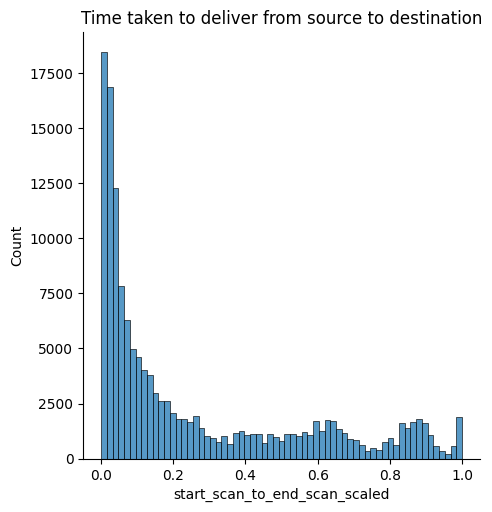

In [171]:
sns.displot(data['start_scan_to_end_scan_scaled'])
plt.title('Time taken to deliver from source to destination')

[]

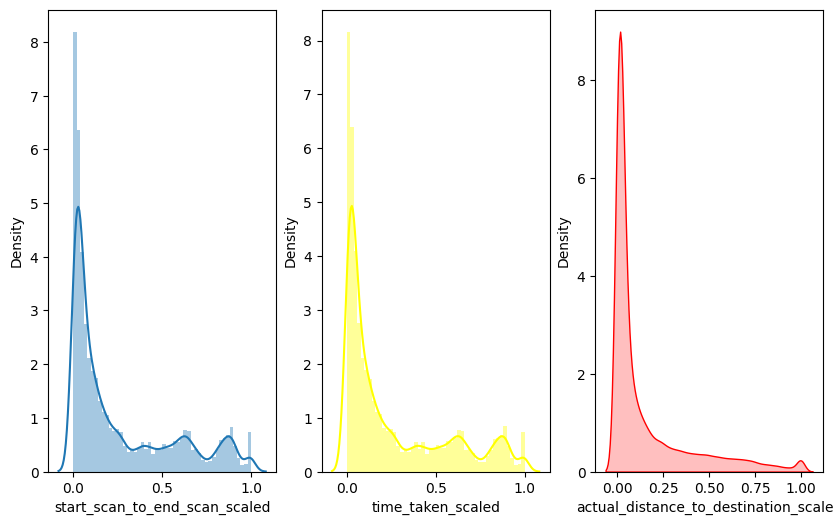

In [172]:
plt.figure(figsize=(10, 6))

plt.subplot(131)  #  1st subplot
sns.distplot(data['start_scan_to_end_scan_scaled'])
plt.plot()

plt.subplot(132)  #  2nd subplot
sns.distplot(data['time_taken_scaled'],color='Yellow')
plt.plot()

plt.subplot(133)
sns.kdeplot(data['actual_distance_to_destination_scaled'],color='Red',shade=True)
plt.plot()

### Bivariate Data Analysis:

**Trip Creation Day**

<Axes: xlabel='month_of_year', ylabel='count'>

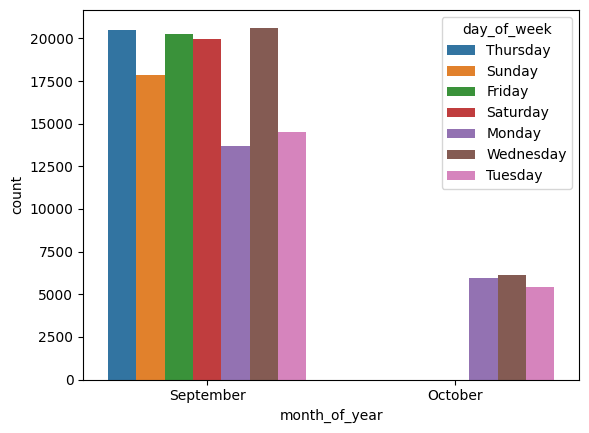

In [173]:
sns.countplot(x=data['month_of_year'],hue=data['day_of_week'])

Majority of trip creation occurred in 9 th month,3 day trip creation in October [M, W,TU]

**Trip Creation Hour**

<Axes: xlabel='hour_of__day', ylabel='count'>

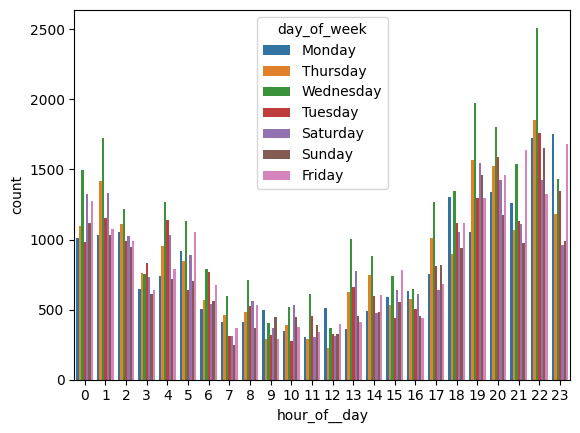

In [174]:
sns.countplot(hue=data['day_of_week'],x=data['hour_of__day'])

Majority of trip creation occurred in Wendesday & Thursuday from  [19:00-1:00Am]

**Comparison of OSRM Time vs Actual Time**

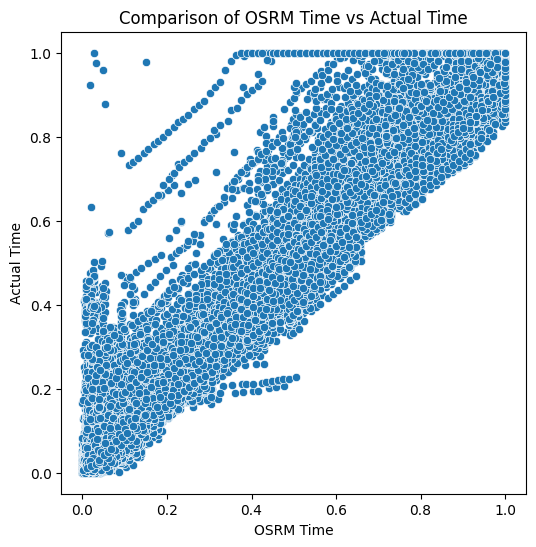

In [175]:
plt.figure(figsize=(6, 6))
sns.scatterplot(data=data, x='osrm_time_scaled', y='actual_time_scaled')
plt.title('Comparison of OSRM Time vs Actual Time')
plt.xlabel('OSRM Time')
plt.ylabel('Actual Time')
plt.show()

There appears to be a positive correlation between OSRM & Actual Time.

**Actual time & OSM Time**

In [176]:
x1=data.groupby('source_state').agg({'actual_time_scaled':'mean','osrm_time_scaled':'mean'}).reset_index()
x1=pd.melt(x1, id_vars=['source_state'], value_vars=['actual_time_scaled', 'osrm_time_scaled'])
x1

,source_state,variable,value
0,Andhra Pradesh,actual_time_scaled,0.049759
1,Arunachal Pradesh,actual_time_scaled,0.048449
2,Assam,actual_time_scaled,0.281430
3,Bihar,actual_time_scaled,0.138835
4,Chandigarh,actual_time_scaled,0.013770
...,...,...,...
57,Telangana,osrm_time_scaled,0.086146
58,Tripura,osrm_time_scaled,0.047513
59,Uttar Pradesh,osrm_time_scaled,0.046721
60,Uttarakhand,osrm_time_scaled,0.060485


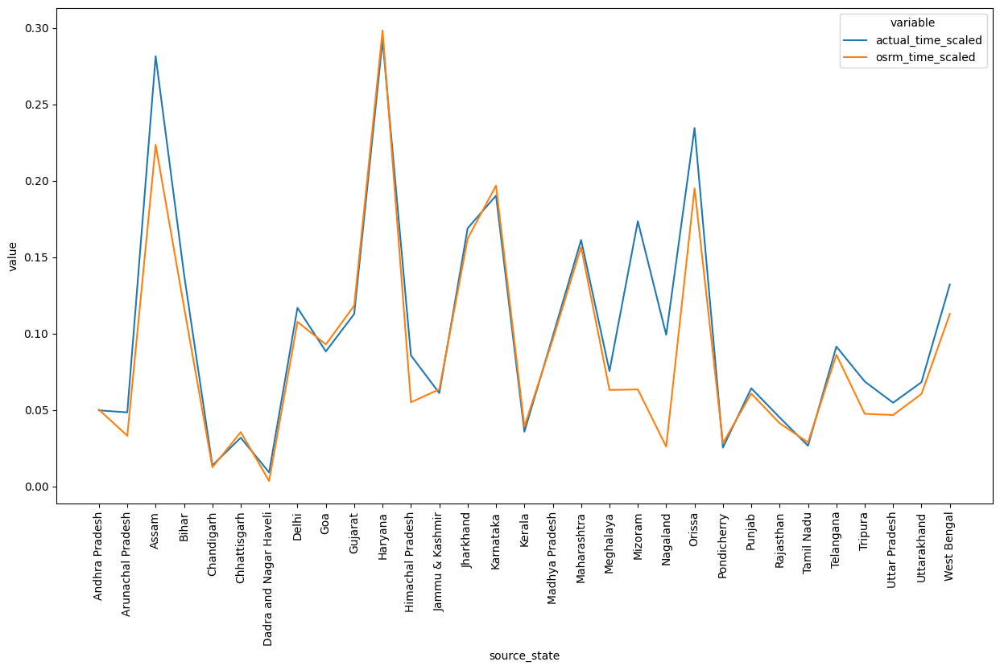

In [177]:
plt.figure(figsize=(15,8))
sns.lineplot(data=x1,x='source_state',y='value',hue='variable')
plt.xticks(rotation=90)
plt.show()


- In Orissa we can see there is high variation in actual and osrm time

In [178]:
# Group by 'hour_of__day' and count the number of 'trip_uuid'
trip_counts = data.groupby('hour_of__day')['trip_uuid'].count().reset_index()

# Now create the line plot using the aggregated data
fig = px.line(trip_counts, x='hour_of__day', y='trip_uuid', markers=True)

fig.update_xaxes(tickvals=list(trip_counts['hour_of__day'].unique()))

fig.update_layout(
    title='Trips created on hour to hour ',
    xaxis_title='Hour',
    yaxis_title='Number of trips Created'
)

fig.show()

A rising trend in the number of trips created is observed from 12 pm to 10 pm, with the highest number recorded at 10 pm.

**plot a subset of variabeles**

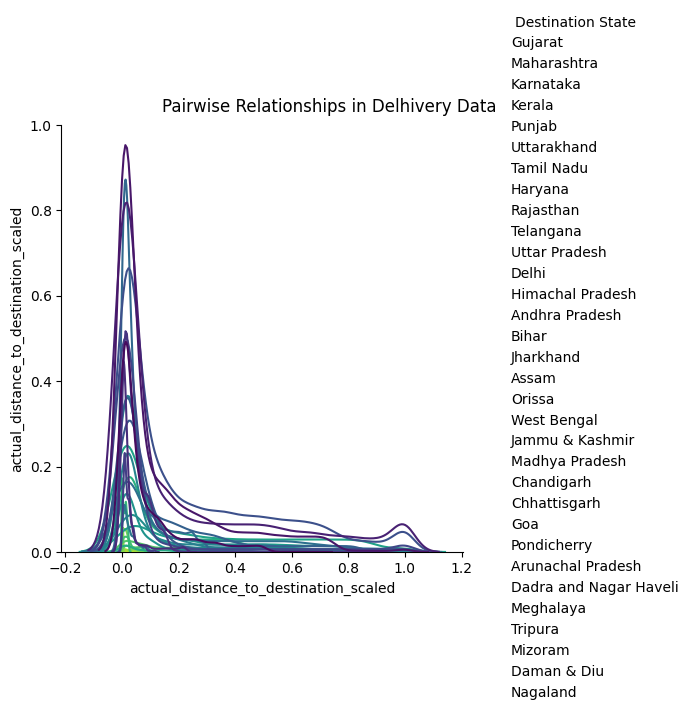

In [179]:
g = sns.PairGrid(data, hue='destination_state', palette='viridis',
                 x_vars=['actual_distance_to_destination_scaled'],
                 y_vars=['actual_distance_to_destination_scaled'],height=5)
g.map_offdiag(sns.regplot)
g.map_diag(sns.kdeplot)
g.add_legend(title='Destination State')
g.fig.suptitle('Pairwise Relationships in Delhivery Data', y=1.02)
plt.show()

**Top  Indian states with most product delivery sources**

Text(0.5, 1.0, 'Top Indian states with most product delivery sources')

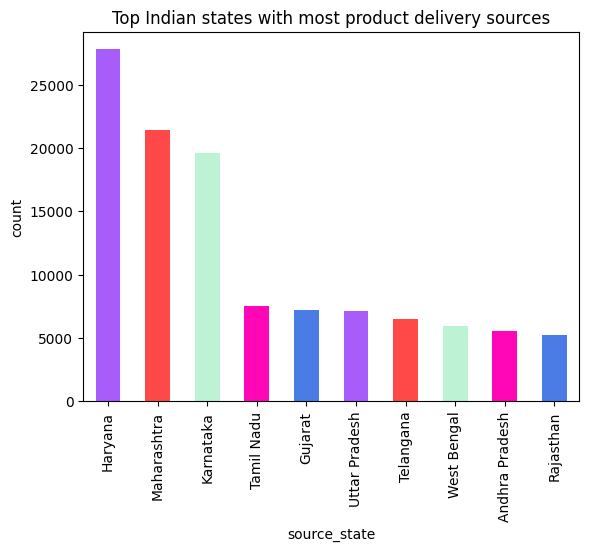

In [180]:
color_sequences = ['#A85CF9','#FF4949','#BDF2D5','#FF06B7','#4B7BE5']
data.groupby('source_state')['trip_uuid'].count().sort_values(ascending=False).head(10).plot(kind='bar',color=color_sequences )
plt.xlabel('source_state')
plt.ylabel('count')
plt.title('Top Indian states with most product delivery sources')

Top 3 Indian states with most product delivery sources are:
- Maharashtra
- Karnataka
- Haryana


**Top  Indian  destination with most product delivery sources**

Text(0.5, 1.0, 'Top Indian states with most product delivery sources')

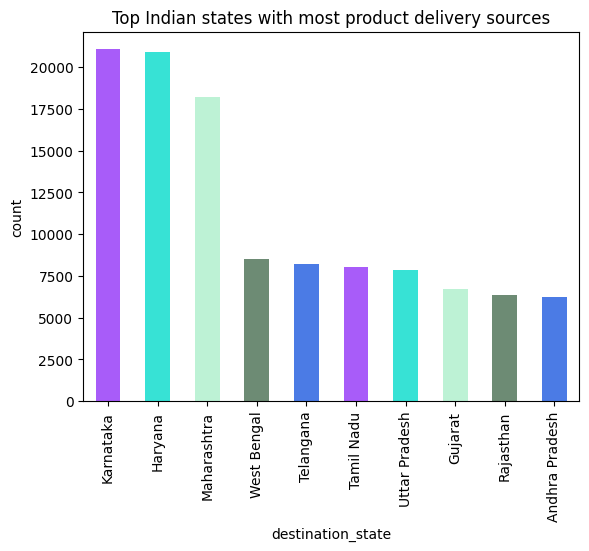

In [181]:
color_sequences = ['#A85CF9','#37E2D5','#BDF2D5','#6D8B74','#4B7BE5']
data.groupby('destination_state')['trip_uuid'].count().sort_values(ascending=False).head(10).plot(kind='bar',color=color_sequences )
plt.xlabel('destination_state')
plt.ylabel('count')
plt.title('Top Indian states with most product delivery sources')

Top 3 Indian states with the most product delivery destinations are :
- Maharashtra
- Karnataka
- Haryana



**Destination places in each state**

Text(0, 0.5, 'count')

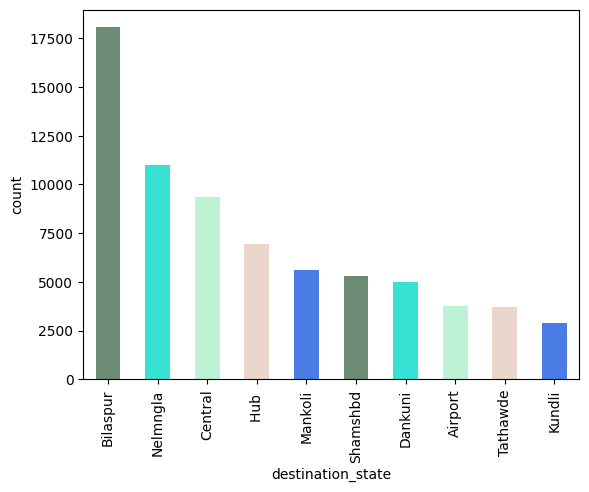

In [182]:
color_sequences = ['#6D8B74','#37E2D5','#BDF2D5','#E9D5CA','#4B7BE5']
data.groupby('destination_place')['trip_uuid'].count().sort_values(ascending=False).head(10).plot(kind='bar',color=color_sequences )
plt.xlabel('destination_state')
plt.ylabel('count')


Bilaspur in Haryana is the most delivered location in the entire state.

**Which city have more delivery ?**

Text(0.5, 1.0, 'Source places in each state')

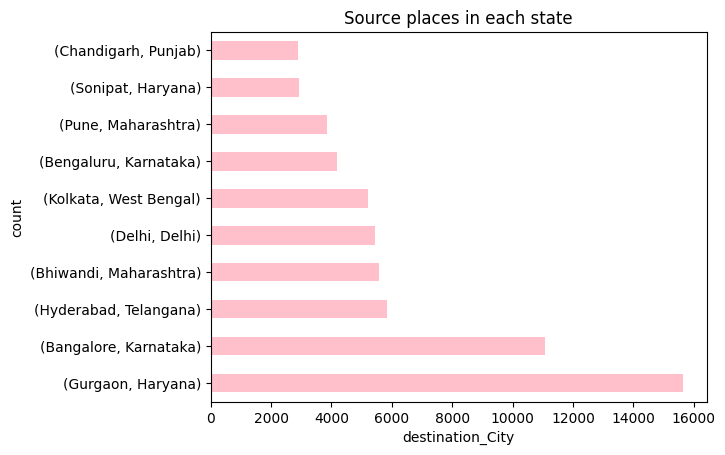

In [183]:
color_sequences = ['pink']
data.groupby(['destination_City','destination_state'])['trip_uuid'].count().sort_values(ascending=False).head(10).plot(kind='barh',color=color_sequences )
plt.xlabel('destination_City')
plt.ylabel('count')
plt.title('Source places in each state')


The cities with most destination centres are :
- Gurgaon
- Bangalore
- Hyderabad



Skewness of numeric features:
segment_factor_scaled                    3.357781
factor_scaled                            2.965432
segment_actual_time_scaled               2.568909
time_to_start_scaled                     2.464051
osrm_distance_scaled                     1.982386
osrm_time_scaled                         1.969818
actual_time_scaled                       1.965658
actual_distance_to_destination_scaled    1.926614
cutoff_factor                            1.924718
segment_osrm_time_scaled                 1.849142
segment_osrm_distance_scaled             1.228211
start_scan_to_end_scan_scaled            1.082086
time_taken_scaled                        1.082084
hour_of__day                            -0.266407
osrm_distance_time_ratio_scaled         -0.948610
distance_time_ratio_scaled              -2.049273
dtype: float64


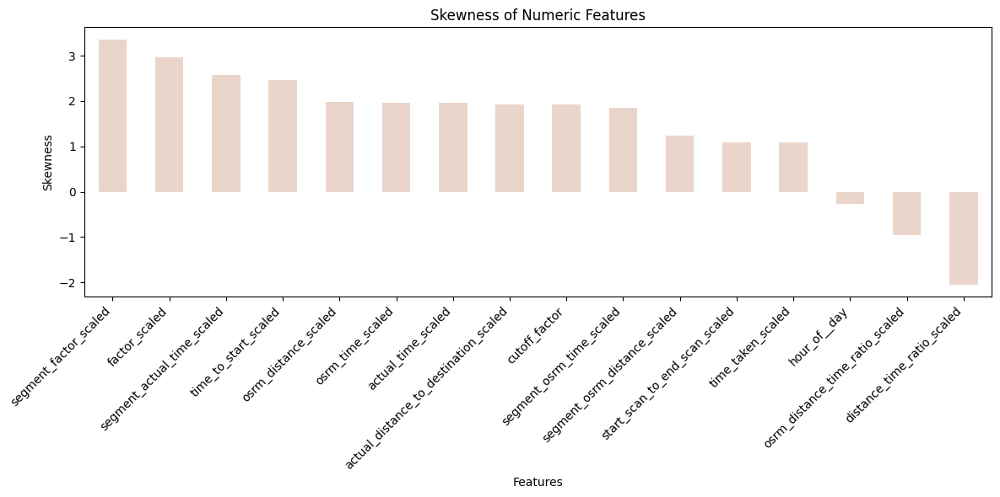

In [184]:
# Calculate skewness for numeric columns
skewness = num.skew().sort_values(ascending=False)

print("Skewness of numeric features:")
print(skewness)

# Visualize skewness
plt.figure(figsize=(12, 6))
color_sequences=['#E9D5CA']
skewness.plot(kind='bar',color=color_sequences)
plt.title('Skewness of Numeric Features')
plt.xlabel('Features')
plt.ylabel('Skewness')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

The factor variable shows moderate positive correlations with time-related features.

<Figure size 1100x600 with 0 Axes>

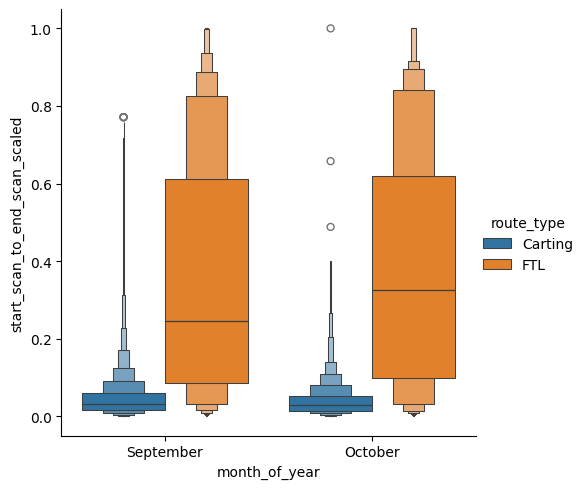

In [185]:
plt.figure(figsize=(11,6))
sns.catplot(data=data,hue='route_type',y='start_scan_to_end_scan_scaled', x='month_of_year',kind='boxen')


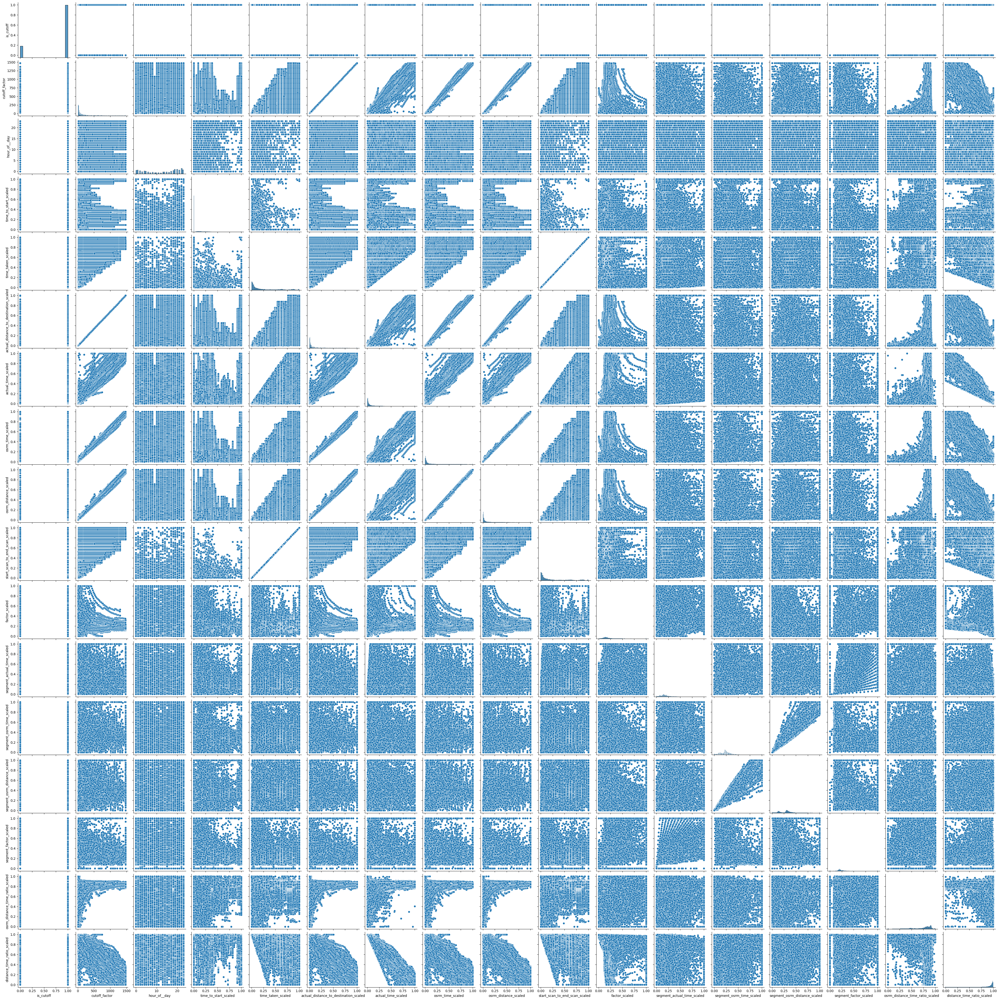

In [186]:
sns.pairplot(data)

 ### Multivariate Data Analysis
   
   - Perform dimensionality reduction techniques such as PCA (Principal Component Analysis) to identify important combinations of features.
   - Explore interactions between multiple features using 3D plots or parallel coordinates plots.
   - Utilize techniques like heatmap or correlation matrix to visualize the correlation structure among all numerical features.

**Create heatmap**

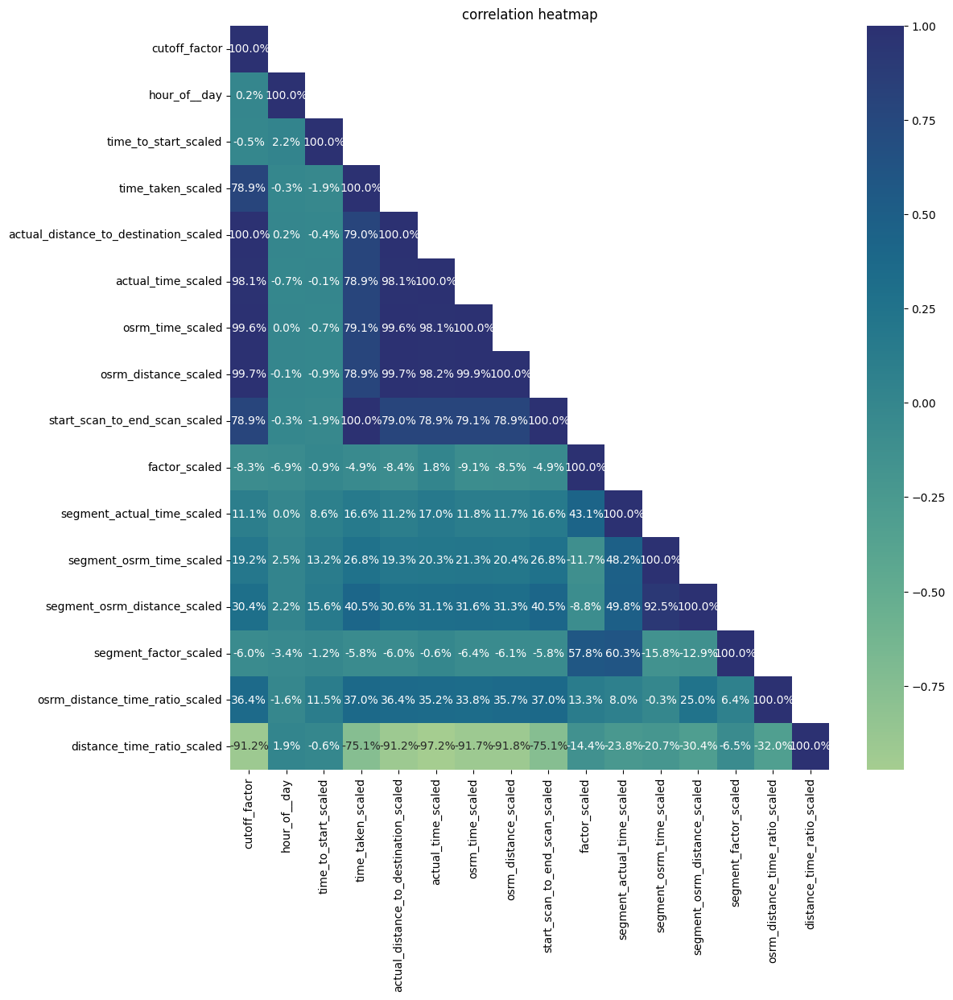

In [187]:
numeric_data = data.select_dtypes(include=['number'])
corr = numeric_data.corr()

# Create the heatmap
plt.figure(figsize=(12, 12))
sns.heatmap(corr, annot=True, cmap='crest', mask=np.triu(corr, +1), fmt="0.0001%")
plt.title('correlation heatmap')
plt.show()

- A statistically significant positive correlation exists between the distance to the destination and the actual delivery time.

- A robust correlation of 0.98 is evident between 'osrm_distance' and 'osrm_time,' indicating a strong positive relationship. Similarly, a comparable relationship is observed between 'Segment_osrm_time' and 'segment_osrm_distance.' The high correlation values signify that changes in distance are highly predictive of corresponding changes in time for both overall and segmented data.

**Principal Component Analysis**

In [188]:
from sklearn.decomposition import PCA
import plotly.express as px
pca=PCA(n_components=2)
principal_components = pca.fit_transform(num)
total_var = pca.explained_variance_ratio_.sum() * 100

In [189]:
# Create a DataFrame from principal components for easier plotting
df = pd.DataFrame(principal_components, columns=['PC1', 'PC2'])

fig = px.scatter(df, x='PC1', y='PC2', title=f'Total Explained Variance: {total_var:.1f}%')
fig.show()

In [190]:
# Create a DataFrame with an additional dummy z-axis
df['PC3'] = np.zeros(len(df))

# Plot the 3D scatter plot
fig = px.scatter_3d(df, x='PC1', y='PC2', z='PC3', title=f'Total Explained Variance: {total_var:.2f}%')
fig.show()

In [191]:
import plotly.express as px

path = ['month_of_year', 'day_of_week', 'route_type']

# Create the sunburst chart
fig = px.sunburst(data_frame=data,
                  path=path,
                  values='actual_distance_to_destination_scaled',color_discrete_map={'(?)':'black'},
                  color='route_type' )
fig.show()

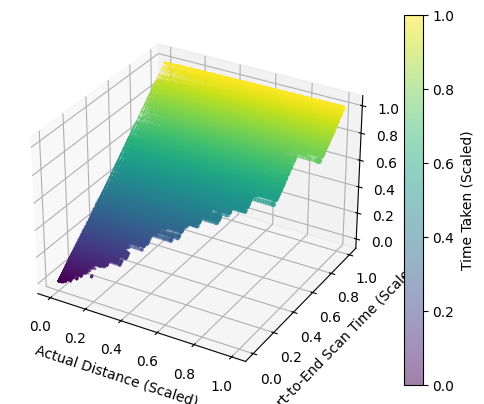

In [192]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # Import for 3D plotting

fig = plt.figure()  # Create a figure
ax = fig.add_subplot(111, projection='3d')  # Create a 3D axes object

# Now use ax.scatter to plot the data and store the result in a variable
scatter_plot = ax.scatter(data['actual_distance_to_destination_scaled'],
                         data['start_scan_to_end_scan_scaled'],
                         data['time_taken_scaled'],
                         c=data['time_taken_scaled'],
                         s=data['actual_distance_to_destination_scaled']*10,
                         alpha=0.5)

ax.set_xlabel('Actual Distance (Scaled)')
ax.set_ylabel('Start-to-End Scan Time (Scaled)')
ax.set_zlabel('Time Taken (Scaled)')

# Pass the scatter plot object to colorbar
plt.colorbar(scatter_plot, label='Time Taken (Scaled)')  # Add a colorbar
plt.show()

**In-depth analysis**

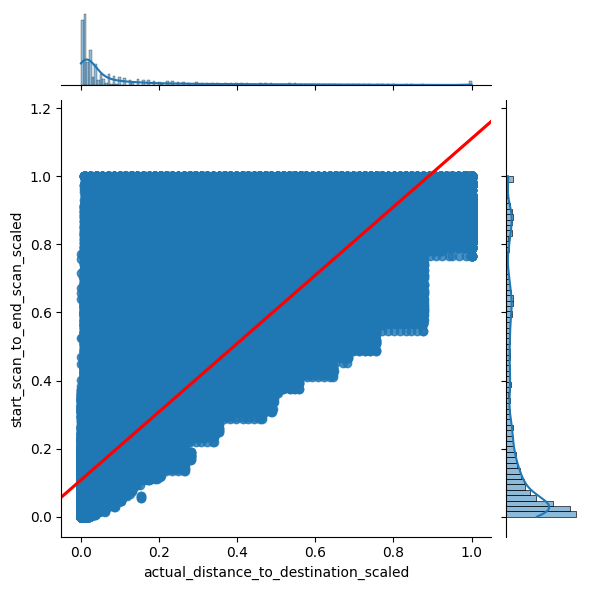

In [193]:
from os import truncate
sns.jointplot(x='actual_distance_to_destination_scaled',
              y='start_scan_to_end_scan_scaled',
              data=data,
              kind='reg',  # For linear regression
              truncate=False,
              line_kws={'color': 'red'})  # Customize regression line color
plt.show()

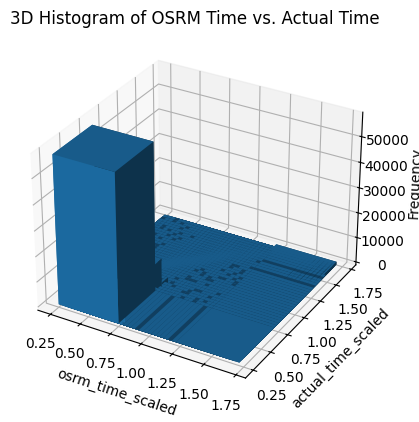

In [194]:
# Create the 3D plot with 2D bar graphs
x = data['osrm_time_scaled']
y = data['actual_time_scaled']
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

hist, xedges, yedges = np.histogram2d(x, y, bins=30)

xpos, ypos = np.meshgrid(xedges[:-1] + 0.25, yedges[:-1] + 0.25, indexing="ij")
xpos = xpos.ravel()
ypos = ypos.ravel()
zpos = 0
dx = dy = 0.5 * np.ones_like(zpos)
dz = hist.ravel()

ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average')

ax.set_xlabel('osrm_time_scaled')
ax.set_ylabel('actual_time_scaled')
ax.set_zlabel('Frequency')
plt.title('3D Histogram of OSRM Time vs. Actual Time')
plt.show()

**Key Findings**

- Strong positive correlations observed between actual time, OSRM time.
- For delivering the products prioritize carting shipments rout type because FTL shipments Full Truck Load takes more time tto deliver product and time taken to actual than that of rout type
- Most of the products were delivered on Wednesday followed by Thursday. The least number of products were delivered on Sunday. This indicates that customers should get products delivered during weekdays other than Sundays or Mondays.
- A rising trend in the number of trips created is observed from 12 pm to 10 pm, with the highest number recorded at 10 pm.
- There is a significant positive correlation between the distance to the destination and the actual delivery time. Longer distances will lead to longer delivery times due to increased travel time and potential delays.
-Similarly, the observed value for actual distance is always higher than the same distance for product delivery. An open-source routing engine that computes the shortest path between points can explain the traffic conditions.